<a href="https://colab.research.google.com/github/drshahizan/Python_EDA/blob/main/assignment/ass2/hpdp/SYNA/casestudy2a/SYNA_CASESTUDY2_a_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# CASE STUDY 2a

# Assignment 2
#### Title : Vaccination of Covid-19 in school of Malaysia
#### Group : SYNA
#### Group Members
#### 1. SARAH WARDINA BINTI RAFIDIN A21EC0128
#### 2. NURUNNAJWA BINTI ZULKIFLI A21EC0121
#### 3. ALYA DAMIA BINTI HUZAIMY A21EC0159
#### 4. YASMEEN NATASHA BINTI HAFIZ SHAHREL A21EC0147


## Data Preparation and Cleansing

Instructions (delete this cell):

- Load the dataset into a data frame using Pandas
- Explore the number of rows & columns, ranges of values etc.
- Handle missing, incorrect and invalid data
- Perform any additional steps (parsing dates, creating additional columns, merging multiple dataset etc.)


 This data provides an overview and analysis of the COVID-19 vaccination data in Malaysian schools, specifically focusing on the dataset titled vax_school.csv. The dataset contains information on vaccination doses administered to staff, students, and various age groups within different schools across Malaysia.

1. First, we import the necessary libraries

In [ ]:
import pandas as pd

import numpy as np

import matplotlib.pyplot as plt

In [ ]:
path = "https://raw.githubusercontent.com/MoH-Malaysia/covid19-public/main/vaccination/vax_school.csv"

In [ ]:
vax = pd.read_csv(path)

# Display the DataFrame
vax

,code,school,state,district,postcode,lat,lon,dose1_staff,dose2_staff,dose3_staff,...,dose2_9,dose2_10,dose2_11,dose2_12,dose2_13,dose2_14,dose2_15,dose2_16,dose2_17,dose2_18
0,ABA0001,SK TOH TANDEWA SAKTI,8,56,35000,4.196633,101.255932,100.0,100.0,92.3,...,NaN,NaN,NaN,83.1,100.0,100.0,NaN,NaN,NaN,NaN
1,ABA0002,SK PENDITA ZA'BA,8,56,35400,4.178276,101.200617,100.0,100.0,81.6,...,NaN,NaN,NaN,82.4,NaN,NaN,NaN,NaN,NaN,NaN
2,ABA0003,SK BANIR,8,56,35400,4.204361,101.181893,100.0,100.0,86.7,...,NaN,NaN,NaN,50.0,NaN,NaN,NaN,NaN,NaN,NaN
3,ABA0004,SK TEMOH,8,56,35350,4.235841,101.172819,100.0,100.0,77.3,...,NaN,NaN,NaN,100.0,NaN,NaN,NaN,NaN,NaN,NaN
4,ABA0005,SK CHENDERIANG,8,56,35300,4.267980,101.240556,100.0,100.0,87.0,...,NaN,NaN,NaN,100.0,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10211,YRA2201,SMK AGAMA SARATOK,13,126,95407,1.763628,111.337767,98.5,98.5,92.4,...,NaN,NaN,NaN,NaN,99.1,100.0,98.7,100.0,100.0,96.2
10212,YRA3101,SMK AGAMA SIBU (S),13,131,96000,2.337200,111.840383,100.0,100.0,96.2,...,NaN,NaN,NaN,NaN,96.3,98.3,96.7,96.3,96.0,100.0
10213,YRA3201,SMK AGAMA IGAN,13,107,96400,2.824150,111.712617,100.0,98.3,88.3,...,NaN,NaN,NaN,100.0,99.1,99.1,98.9,98.8,100.0,100.0
10214,YRA4101,SMK AGAMA,13,121,98000,4.298633,113.955867,100.0,100.0,91.9,...,NaN,NaN,NaN,100.0,97.6,95.4,99.3,98.0,100.0,97.5


2. The dataset has been downloaded and extracted.

3. Find info about this dataset



The dataset consists of 10,216 entries and 40 columns, capturing detailed information about vaccination activities in schools. Here is a summary of the key columns:

- code: School codes for identification.
- school: School names.
- state, district, postcode: Geographic information of the schools.
- lat, lon: Latitude and longitude coordinates of the schools.
- dose1_staff, dose2_staff, dose3_staff: Vaccination doses administered to staff members.
- dose1_student, dose2_student: Vaccination doses administered to students.
- Columns from dose1_5 to dose2_18: Possible vaccination doses administered to different age groups, with varying levels of missing data.

In [ ]:
vax.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10216 entries, 0 to 10215
Data columns (total 40 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   code           10216 non-null  object 
 1   school         10216 non-null  object 
 2   state          10216 non-null  int64  
 3   district       10216 non-null  int64  
 4   postcode       10216 non-null  int64  
 5   lat            10216 non-null  float64
 6   lon            10216 non-null  float64
 7   dose1_staff    10212 non-null  float64
 8   dose2_staff    10212 non-null  float64
 9   dose3_staff    10212 non-null  float64
 10  dose1_student  10174 non-null  float64
 11  dose2_student  10174 non-null  float64
 12  dose1_5        0 non-null      float64
 13  dose1_6        0 non-null      float64
 14  dose1_7        0 non-null      float64
 15  dose1_8        0 non-null      float64
 16  dose1_9        0 non-null      float64
 17  dose1_10       0 non-null      float64
 18  dose1_

4. Above show the info of the dataset

5. Next, drop column with all null values  which are dose1_5 to dose2_18

In [ ]:
vax_cleaned = vax.dropna(axis=1, how='all')

In [ ]:
vax_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10216 entries, 0 to 10215
Data columns (total 26 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   code           10216 non-null  object 
 1   school         10216 non-null  object 
 2   state          10216 non-null  int64  
 3   district       10216 non-null  int64  
 4   postcode       10216 non-null  int64  
 5   lat            10216 non-null  float64
 6   lon            10216 non-null  float64
 7   dose1_staff    10212 non-null  float64
 8   dose2_staff    10212 non-null  float64
 9   dose3_staff    10212 non-null  float64
 10  dose1_student  10174 non-null  float64
 11  dose2_student  10174 non-null  float64
 12  dose1_12       8526 non-null   float64
 13  dose1_13       3552 non-null   float64
 14  dose1_14       2976 non-null   float64
 15  dose1_15       2552 non-null   float64
 16  dose1_16       2414 non-null   float64
 17  dose1_17       2418 non-null   float64
 18  dose1_

6. Info above shows that column has reduce from 40 columns to 26 columns

7. Fill missing values in specific columns with appropriate mean values

In [ ]:
numerical_columns = vax_cleaned.select_dtypes(include=['float64']).columns
vax_cleaned[numerical_columns] = vax_cleaned[numerical_columns].fillna(vax_cleaned[numerical_columns].mean())

<ipython-input-7-a1a37cb6b63e>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  vax_cleaned[numerical_columns] = vax_cleaned[numerical_columns].fillna(vax_cleaned[numerical_columns].mean())


In [ ]:
vax_cleaned.head()

,code,school,state,district,postcode,lat,lon,dose1_staff,dose2_staff,dose3_staff,...,dose1_16,dose1_17,dose1_18,dose2_12,dose2_13,dose2_14,dose2_15,dose2_16,dose2_17,dose2_18
0,ABA0001,SK TOH TANDEWA SAKTI,8,56,35000,4.196633,101.255932,100.0,100.0,92.3,...,98.119345,98.521671,98.141756,83.1,100.000000,100.00000,89.350705,97.354805,97.802936,97.297899
1,ABA0002,SK PENDITA ZA'BA,8,56,35400,4.178276,101.200617,100.0,100.0,81.6,...,98.119345,98.521671,98.141756,82.4,89.561571,95.01287,89.350705,97.354805,97.802936,97.297899
2,ABA0003,SK BANIR,8,56,35400,4.204361,101.181893,100.0,100.0,86.7,...,98.119345,98.521671,98.141756,50.0,89.561571,95.01287,89.350705,97.354805,97.802936,97.297899
3,ABA0004,SK TEMOH,8,56,35350,4.235841,101.172819,100.0,100.0,77.3,...,98.119345,98.521671,98.141756,100.0,89.561571,95.01287,89.350705,97.354805,97.802936,97.297899
4,ABA0005,SK CHENDERIANG,8,56,35300,4.267980,101.240556,100.0,100.0,87.0,...,98.119345,98.521671,98.141756,100.0,89.561571,95.01287,89.350705,97.354805,97.802936,97.297899


8. The NaN value has changed to mean values

In [ ]:
vax_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10216 entries, 0 to 10215
Data columns (total 26 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   code           10216 non-null  object 
 1   school         10216 non-null  object 
 2   state          10216 non-null  int64  
 3   district       10216 non-null  int64  
 4   postcode       10216 non-null  int64  
 5   lat            10216 non-null  float64
 6   lon            10216 non-null  float64
 7   dose1_staff    10216 non-null  float64
 8   dose2_staff    10216 non-null  float64
 9   dose3_staff    10216 non-null  float64
 10  dose1_student  10216 non-null  float64
 11  dose2_student  10216 non-null  float64
 12  dose1_12       10216 non-null  float64
 13  dose1_13       10216 non-null  float64
 14  dose1_14       10216 non-null  float64
 15  dose1_15       10216 non-null  float64
 16  dose1_16       10216 non-null  float64
 17  dose1_17       10216 non-null  float64
 18  dose1_

9. Find unique values in the 'school' column



In [ ]:
unique_values = vax_cleaned.stack().unique()
unique_values


array(['ABA0001', 'SK TOH TANDEWA SAKTI', 8, ..., 'SMK AGAMA LIMBANG',
       4.684616667, 115.0128333], dtype=object)

10. Remove duplicate column in all columns

In [ ]:
duplicate_rows = vax_cleaned.duplicated()

In [ ]:
duplicates = vax_cleaned[duplicate_rows]
print(duplicates)

Empty DataFrame
Columns: [code, school, state, district, postcode, lat, lon, dose1_staff, dose2_staff, dose3_staff, dose1_student, dose2_student, dose1_12, dose1_13, dose1_14, dose1_15, dose1_16, dose1_17, dose1_18, dose2_12, dose2_13, dose2_14, dose2_15, dose2_16, dose2_17, dose2_18]
Index: []

[0 rows x 26 columns]


In [ ]:
vax_cleaned = vax_cleaned.drop_duplicates()

In [ ]:
vax_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 10216 entries, 0 to 10215
Data columns (total 26 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   code           10216 non-null  object 
 1   school         10216 non-null  object 
 2   state          10216 non-null  int64  
 3   district       10216 non-null  int64  
 4   postcode       10216 non-null  int64  
 5   lat            10216 non-null  float64
 6   lon            10216 non-null  float64
 7   dose1_staff    10216 non-null  float64
 8   dose2_staff    10216 non-null  float64
 9   dose3_staff    10216 non-null  float64
 10  dose1_student  10216 non-null  float64
 11  dose2_student  10216 non-null  float64
 12  dose1_12       10216 non-null  float64
 13  dose1_13       10216 non-null  float64
 14  dose1_14       10216 non-null  float64
 15  dose1_15       10216 non-null  float64
 16  dose1_16       10216 non-null  float64
 17  dose1_17       10216 non-null  float64
 18  dose1_

11. Info above shows there are no duplicate column and rows

12. Reset index after dropping rows


In [ ]:
vax_cleaned.reset_index(drop=True, inplace=True)

In [ ]:
vax_cleaned.head()

,code,school,state,district,postcode,lat,lon,dose1_staff,dose2_staff,dose3_staff,...,dose1_16,dose1_17,dose1_18,dose2_12,dose2_13,dose2_14,dose2_15,dose2_16,dose2_17,dose2_18
0,ABA0001,SK TOH TANDEWA SAKTI,8,56,35000,4.196633,101.255932,100.0,100.0,92.3,...,98.119345,98.521671,98.141756,83.1,100.000000,100.00000,89.350705,97.354805,97.802936,97.297899
1,ABA0002,SK PENDITA ZA'BA,8,56,35400,4.178276,101.200617,100.0,100.0,81.6,...,98.119345,98.521671,98.141756,82.4,89.561571,95.01287,89.350705,97.354805,97.802936,97.297899
2,ABA0003,SK BANIR,8,56,35400,4.204361,101.181893,100.0,100.0,86.7,...,98.119345,98.521671,98.141756,50.0,89.561571,95.01287,89.350705,97.354805,97.802936,97.297899
3,ABA0004,SK TEMOH,8,56,35350,4.235841,101.172819,100.0,100.0,77.3,...,98.119345,98.521671,98.141756,100.0,89.561571,95.01287,89.350705,97.354805,97.802936,97.297899
4,ABA0005,SK CHENDERIANG,8,56,35300,4.267980,101.240556,100.0,100.0,87.0,...,98.119345,98.521671,98.141756,100.0,89.561571,95.01287,89.350705,97.354805,97.802936,97.297899


In [ ]:
vax_cleaned.tail()

,code,school,state,district,postcode,lat,lon,dose1_staff,dose2_staff,dose3_staff,...,dose1_16,dose1_17,dose1_18,dose2_12,dose2_13,dose2_14,dose2_15,dose2_16,dose2_17,dose2_18
10211,YRA2201,SMK AGAMA SARATOK,13,126,95407,1.763628,111.337767,98.5,98.5,92.4,...,100.0,100.0,96.2,90.714215,99.1,100.0,98.7,100.0,100.0,96.2
10212,YRA3101,SMK AGAMA SIBU (S),13,131,96000,2.337200,111.840383,100.0,100.0,96.2,...,97.2,97.0,100.0,90.714215,96.3,98.3,96.7,96.3,96.0,100.0
10213,YRA3201,SMK AGAMA IGAN,13,107,96400,2.824150,111.712617,100.0,98.3,88.3,...,98.8,100.0,100.0,100.000000,99.1,99.1,98.9,98.8,100.0,100.0
10214,YRA4101,SMK AGAMA,13,121,98000,4.298633,113.955867,100.0,100.0,91.9,...,98.0,100.0,97.5,100.000000,97.6,95.4,99.3,98.0,100.0,97.5
10215,YRA5101,SMK AGAMA LIMBANG,13,115,98700,4.684617,115.012833,100.0,100.0,89.2,...,98.9,96.6,98.7,90.714215,100.0,98.9,96.6,98.9,96.6,98.7


13. Round all float columns to 2 decimal places


In [ ]:
vax_cleaned = vax_cleaned.round(2)

In [ ]:
vax_cleaned.head()

,code,school,state,district,postcode,lat,lon,dose1_staff,dose2_staff,dose3_staff,...,dose1_16,dose1_17,dose1_18,dose2_12,dose2_13,dose2_14,dose2_15,dose2_16,dose2_17,dose2_18
0,ABA0001,SK TOH TANDEWA SAKTI,8,56,35000,4.20,101.26,100.0,100.0,92.3,...,98.12,98.52,98.14,83.1,100.00,100.00,89.35,97.35,97.8,97.3
1,ABA0002,SK PENDITA ZA'BA,8,56,35400,4.18,101.20,100.0,100.0,81.6,...,98.12,98.52,98.14,82.4,89.56,95.01,89.35,97.35,97.8,97.3
2,ABA0003,SK BANIR,8,56,35400,4.20,101.18,100.0,100.0,86.7,...,98.12,98.52,98.14,50.0,89.56,95.01,89.35,97.35,97.8,97.3
3,ABA0004,SK TEMOH,8,56,35350,4.24,101.17,100.0,100.0,77.3,...,98.12,98.52,98.14,100.0,89.56,95.01,89.35,97.35,97.8,97.3
4,ABA0005,SK CHENDERIANG,8,56,35300,4.27,101.24,100.0,100.0,87.0,...,98.12,98.52,98.14,100.0,89.56,95.01,89.35,97.35,97.8,97.3


In [ ]:
vax_cleaned.tail()

,code,school,state,district,postcode,lat,lon,dose1_staff,dose2_staff,dose3_staff,...,dose1_16,dose1_17,dose1_18,dose2_12,dose2_13,dose2_14,dose2_15,dose2_16,dose2_17,dose2_18
10211,YRA2201,SMK AGAMA SARATOK,13,126,95407,1.76,111.34,98.5,98.5,92.4,...,100.0,100.0,96.2,90.71,99.1,100.0,98.7,100.0,100.0,96.2
10212,YRA3101,SMK AGAMA SIBU (S),13,131,96000,2.34,111.84,100.0,100.0,96.2,...,97.2,97.0,100.0,90.71,96.3,98.3,96.7,96.3,96.0,100.0
10213,YRA3201,SMK AGAMA IGAN,13,107,96400,2.82,111.71,100.0,98.3,88.3,...,98.8,100.0,100.0,100.00,99.1,99.1,98.9,98.8,100.0,100.0
10214,YRA4101,SMK AGAMA,13,121,98000,4.30,113.96,100.0,100.0,91.9,...,98.0,100.0,97.5,100.00,97.6,95.4,99.3,98.0,100.0,97.5
10215,YRA5101,SMK AGAMA LIMBANG,13,115,98700,4.68,115.01,100.0,100.0,89.2,...,98.9,96.6,98.7,90.71,100.0,98.9,96.6,98.9,96.6,98.7


14. All the float data type column has set to two decimal places

15. Change the data type of state and postcode into string

In [ ]:
# Convert 'state' and 'district' columns to strings
vax_cleaned['state'] = vax_cleaned['state'].astype(str)
vax_cleaned['district'] = vax_cleaned['district'].astype(str)

In [ ]:
vax_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10216 entries, 0 to 10215
Data columns (total 26 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   code           10216 non-null  object 
 1   school         10216 non-null  object 
 2   state          10216 non-null  object 
 3   district       10216 non-null  object 
 4   postcode       10216 non-null  int64  
 5   lat            10216 non-null  float64
 6   lon            10216 non-null  float64
 7   dose1_staff    10216 non-null  float64
 8   dose2_staff    10216 non-null  float64
 9   dose3_staff    10216 non-null  float64
 10  dose1_student  10216 non-null  float64
 11  dose2_student  10216 non-null  float64
 12  dose1_12       10216 non-null  float64
 13  dose1_13       10216 non-null  float64
 14  dose1_14       10216 non-null  float64
 15  dose1_15       10216 non-null  float64
 16  dose1_16       10216 non-null  float64
 17  dose1_17       10216 non-null  float64
 18  dose1_

16. State and district succeccfully changed to string data type

In [ ]:
vax_cleaned.head()

,code,school,state,district,postcode,lat,lon,dose1_staff,dose2_staff,dose3_staff,...,dose1_16,dose1_17,dose1_18,dose2_12,dose2_13,dose2_14,dose2_15,dose2_16,dose2_17,dose2_18
0,ABA0001,SK TOH TANDEWA SAKTI,8,56,35000,4.20,101.26,100.0,100.0,92.3,...,98.12,98.52,98.14,83.1,100.00,100.00,89.35,97.35,97.8,97.3
1,ABA0002,SK PENDITA ZA'BA,8,56,35400,4.18,101.20,100.0,100.0,81.6,...,98.12,98.52,98.14,82.4,89.56,95.01,89.35,97.35,97.8,97.3
2,ABA0003,SK BANIR,8,56,35400,4.20,101.18,100.0,100.0,86.7,...,98.12,98.52,98.14,50.0,89.56,95.01,89.35,97.35,97.8,97.3
3,ABA0004,SK TEMOH,8,56,35350,4.24,101.17,100.0,100.0,77.3,...,98.12,98.52,98.14,100.0,89.56,95.01,89.35,97.35,97.8,97.3
4,ABA0005,SK CHENDERIANG,8,56,35300,4.27,101.24,100.0,100.0,87.0,...,98.12,98.52,98.14,100.0,89.56,95.01,89.35,97.35,97.8,97.3


In [ ]:
vax_cleaned.tail()

,code,school,state,district,postcode,lat,lon,dose1_staff,dose2_staff,dose3_staff,...,dose1_16,dose1_17,dose1_18,dose2_12,dose2_13,dose2_14,dose2_15,dose2_16,dose2_17,dose2_18
10211,YRA2201,SMK AGAMA SARATOK,13,126,95407,1.76,111.34,98.5,98.5,92.4,...,100.0,100.0,96.2,90.71,99.1,100.0,98.7,100.0,100.0,96.2
10212,YRA3101,SMK AGAMA SIBU (S),13,131,96000,2.34,111.84,100.0,100.0,96.2,...,97.2,97.0,100.0,90.71,96.3,98.3,96.7,96.3,96.0,100.0
10213,YRA3201,SMK AGAMA IGAN,13,107,96400,2.82,111.71,100.0,98.3,88.3,...,98.8,100.0,100.0,100.00,99.1,99.1,98.9,98.8,100.0,100.0
10214,YRA4101,SMK AGAMA,13,121,98000,4.30,113.96,100.0,100.0,91.9,...,98.0,100.0,97.5,100.00,97.6,95.4,99.3,98.0,100.0,97.5
10215,YRA5101,SMK AGAMA LIMBANG,13,115,98700,4.68,115.01,100.0,100.0,89.2,...,98.9,96.6,98.7,90.71,100.0,98.9,96.6,98.9,96.6,98.7


In [ ]:
vax_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10216 entries, 0 to 10215
Data columns (total 26 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   code           10216 non-null  object 
 1   school         10216 non-null  object 
 2   state          10216 non-null  object 
 3   district       10216 non-null  object 
 4   postcode       10216 non-null  int64  
 5   lat            10216 non-null  float64
 6   lon            10216 non-null  float64
 7   dose1_staff    10216 non-null  float64
 8   dose2_staff    10216 non-null  float64
 9   dose3_staff    10216 non-null  float64
 10  dose1_student  10216 non-null  float64
 11  dose2_student  10216 non-null  float64
 12  dose1_12       10216 non-null  float64
 13  dose1_13       10216 non-null  float64
 14  dose1_14       10216 non-null  float64
 15  dose1_15       10216 non-null  float64
 16  dose1_16       10216 non-null  float64
 17  dose1_17       10216 non-null  float64
 18  dose1_

17. Dataset successfully prep and cleaned

## 1. AutoViz

### Data Preparation

1. Import Libraries

In [ ]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

import warnings
warnings.filterwarnings('ignore')

2. Install Autoviz

In [ ]:
!pip install autoviz

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 2.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.5/18.5 MB 60.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 397.5/397.5 kB 41.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.3/4.3 MB 23.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 93.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 86.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 87.3/87.3 kB 9.4 MB/s eta 0:00:00
INFO: pip is looking at multiple versions of panel to determine which version is compatible with other requirements. This could take a while.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.1/20.1 MB 45.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.4/20.4 MB 13.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.4/20.4 MB 16.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.1/20.

3. Once Autoviz is installed, you can import your data into the tool using a variety of file formats, including CSV, Excel, and JSON.

In [ ]:
url='https://raw.githubusercontent.com/MoH-Malaysia/covid19-public/main/vaccination/vax_school.csv'
data = pd.read_csv(url)
data.head()

,code,school,state,district,postcode,lat,lon,dose1_staff,dose2_staff,dose3_staff,...,dose2_9,dose2_10,dose2_11,dose2_12,dose2_13,dose2_14,dose2_15,dose2_16,dose2_17,dose2_18
0,ABA0001,SK TOH TANDEWA SAKTI,8,56,35000,4.196633,101.255932,100.0,100.0,92.3,...,NaN,NaN,NaN,83.1,100.0,100.0,NaN,NaN,NaN,NaN
1,ABA0002,SK PENDITA ZA'BA,8,56,35400,4.178276,101.200617,100.0,100.0,81.6,...,NaN,NaN,NaN,82.4,NaN,NaN,NaN,NaN,NaN,NaN
2,ABA0003,SK BANIR,8,56,35400,4.204361,101.181893,100.0,100.0,86.7,...,NaN,NaN,NaN,50.0,NaN,NaN,NaN,NaN,NaN,NaN
3,ABA0004,SK TEMOH,8,56,35350,4.235841,101.172819,100.0,100.0,77.3,...,NaN,NaN,NaN,100.0,NaN,NaN,NaN,NaN,NaN,NaN
4,ABA0005,SK CHENDERIANG,8,56,35300,4.267980,101.240556,100.0,100.0,87.0,...,NaN,NaN,NaN,100.0,NaN,NaN,NaN,NaN,NaN,NaN


### Implementation of Automated EDA Tools

4. You can use Autoviz to generate visualizations. Autoviz have a function called “AutoViz_Class” that takes in a pandas DataFrame and generates visualizations.

5. You must perform %matplotlib inline just before you run AutoViz on your data to avoid AutoViz no displays plots automatically.


In [ ]:
from autoviz.AutoViz_Class import AutoViz_Class

url='https://raw.githubusercontent.com/MoH-Malaysia/covid19-public/main/vaccination/vax_school.csv'
data = pd.read_csv(url)

AV = AutoViz_Class()



%matplotlib inline

Imported v0.1.731. After importing autoviz, execute '%matplotlib inline' to display charts inline.
    AV = AutoViz_Class()
    dfte = AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=1, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)


6. Generate Visualization

Shape of your Data Set loaded: (10216, 40)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
    40 Predictors classified...
        15 variable(s) removed since they were ID or low-information variables
        List of variables removed: ['code', 'dose1_5', 'dose1_6', 'dose1_7', 'dose1_8', 'dose1_9', 'dose1_10', 'dose1_11', 'dose2_5', 'dose2_6', 'dose2_7', 'dose2_8', 'dose2_9', 'dose2_10', 'dose2_11']
   Total columns > 30, too numerous to print.
To fix data quality issues automatically, import FixDQ from autoviz...


,Data Type,Missing Values%,Unique Values%,Minimum Value,Maximum Value,DQ Issue
code,object,0.000000,100,nan,nan,"Possible ID colum: drop before modeling process., 10216 rare categories: Too many to list. Group them into a single category or drop the categories., high cardinality with 10216 unique values: Use hash encoding or embedding to reduce dimension."
school,object,0.000000,94,nan,nan,"9607 rare categories: Too many to list. Group them into a single category or drop the categories., high cardinality with 9607 unique values: Use hash encoding or embedding to reduce dimension."
state,int64,0.000000,0,1.000000,16.000000,No issue
district,int64,0.000000,1,1.000000,159.000000,has a high correlation with ['state']. Consider dropping one of them.
postcode,int64,0.000000,10,1000.000000,98850.000000,No issue
lat,float64,0.000000,NA,0.889139,7.359100,No issue
lon,float64,0.000000,NA,99.715322,119.255970,No issue
dose1_staff,float64,0.039154,NA,70.800000,100.000000,"4 missing values. Impute them with mean, median, mode, or a constant value such as 123., has 2042 outliers greater than upper bound (100.00) or lower than lower bound(100.00). Cap them or remove them."
dose2_staff,float64,0.039154,NA,63.600000,100.000000,"4 missing values. Impute them with mean, median, mode, or a constant value such as 123., has 2476 outliers greater than upper bound (100.00) or lower than lower bound(100.00). Cap them or remove them., has a high correlation with ['dose1_staff']. Consider dropping one of them."
dose3_staff,float64,0.039154,NA,0.000000,100.000000,"4 missing values. Impute them with mean, median, mode, or a constant value such as 123., has 30 outliers greater than upper bound (128.75) or lower than lower bound(18.75). Cap them or remove them."


Number of All Scatter Plots = 231


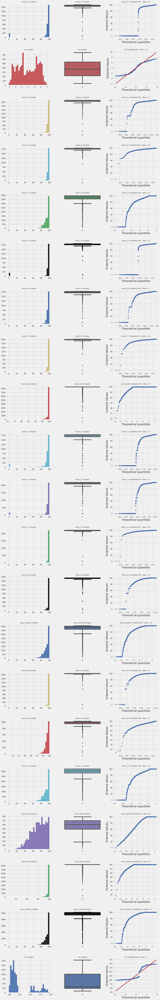

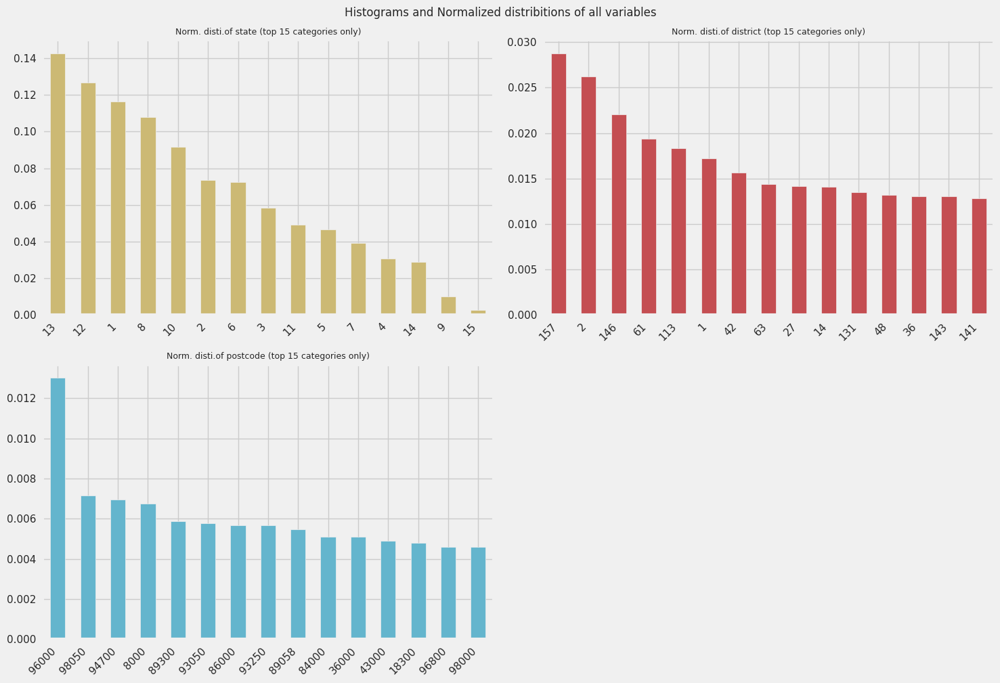

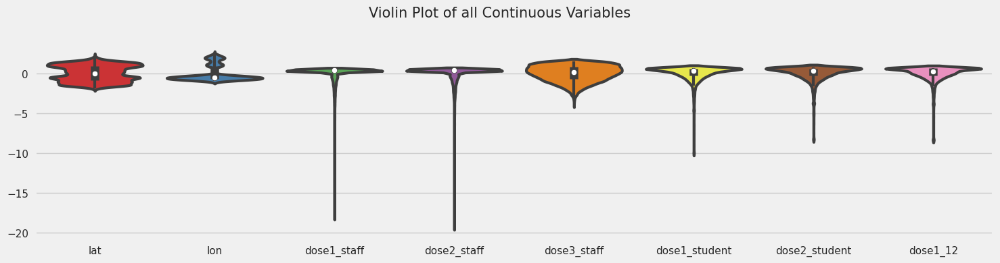

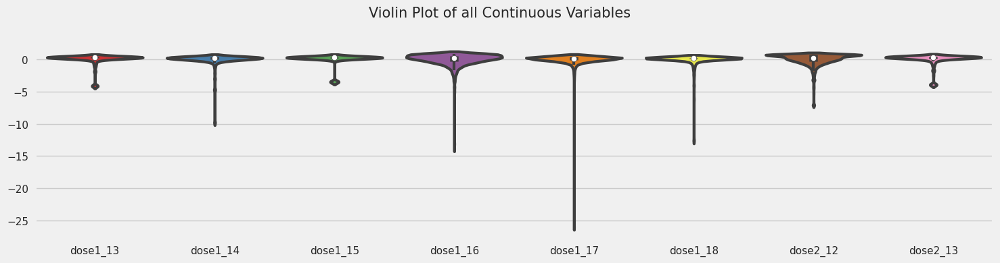

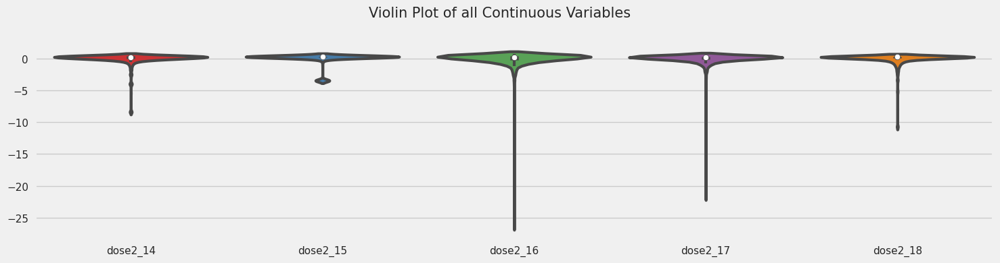

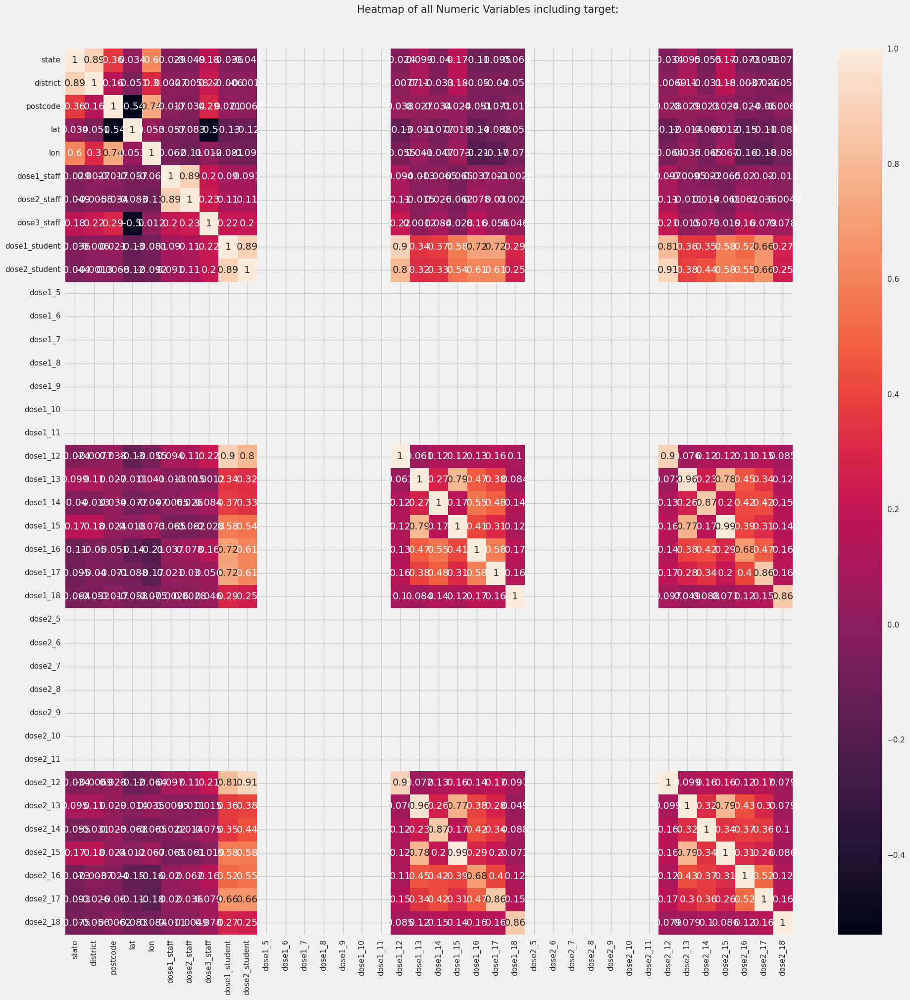

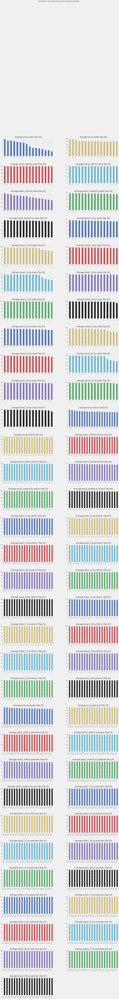

[nltk_data] Downloading collection 'popular'
[nltk_data]    | 
[nltk_data]    | Downloading package cmudict to /root/nltk_data...
[nltk_data]    |   Unzipping corpora/cmudict.zip.
[nltk_data]    | Downloading package gazetteers to /root/nltk_data...
[nltk_data]    |   Unzipping corpora/gazetteers.zip.
[nltk_data]    | Downloading package genesis to /root/nltk_data...
[nltk_data]    |   Unzipping corpora/genesis.zip.
[nltk_data]    | Downloading package gutenberg to /root/nltk_data...
[nltk_data]    |   Unzipping corpora/gutenberg.zip.
[nltk_data]    | Downloading package inaugural to /root/nltk_data...
[nltk_data]    |   Unzipping corpora/inaugural.zip.
[nltk_data]    | Downloading package movie_reviews to
[nltk_data]    |     /root/nltk_data...
[nltk_data]    |   Unzipping corpora/movie_reviews.zip.
[nltk_data]    | Downloading package names to /root/nltk_data...
[nltk_data]    |   Unzipping corpora/names.zip.
[nltk_data]    | Downloading package shakespeare to /root/nltk_data...
[nlt

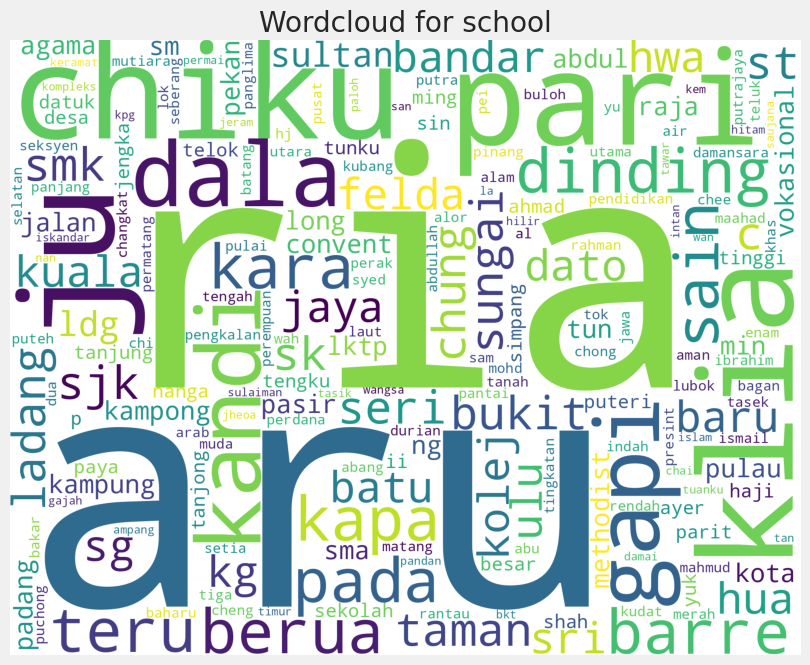

All Plots done
Time to run AutoViz = 156 seconds 

 ###################### AUTO VISUALIZATION Completed ########################


,code,school,state,district,postcode,lat,lon,dose1_staff,dose2_staff,dose3_staff,dose1_student,dose2_student,dose1_5,dose1_6,dose1_7,dose1_8,dose1_9,dose1_10,dose1_11,dose1_12,dose1_13,dose1_14,dose1_15,dose1_16,dose1_17,dose1_18,dose2_5,dose2_6,dose2_7,dose2_8,dose2_9,dose2_10,dose2_11,dose2_12,dose2_13,dose2_14,dose2_15,dose2_16,dose2_17,dose2_18
0,ABA0001,SK TOH TANDEWA SAKTI,8,56,35000,4.196633,101.255932,100.0,100.0,92.3,89.9,83.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,89.6,100.0,100.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.1,100.0,100.0,NaN,NaN,NaN,NaN
1,ABA0002,SK PENDITA ZA'BA,8,56,35400,4.178276,101.200617,100.0,100.0,81.6,88.2,82.4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,88.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.4,NaN,NaN,NaN,NaN,NaN,NaN
2,ABA0003,SK BANIR,8,56,35400,4.204361,101.181893,100.0,100.0,86.7,50.0,50.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,50.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,50.0,NaN,NaN,NaN,NaN,NaN,NaN
3,ABA0004,SK TEMOH,8,56,35350,4.235841,101.172819,100.0,100.0,77.3,100.0,100.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,100.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,100.0,NaN,NaN,NaN,NaN,NaN,NaN
4,ABA0005,SK CHENDERIANG,8,56,35300,4.267980,101.240556,100.0,100.0,87.0,100.0,100.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,100.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,100.0,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10211,YRA2201,SMK AGAMA SARATOK,13,126,95407,1.763628,111.337767,98.5,98.5,92.4,99.3,99.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,99.1,100.0,98.7,100.0,100.0,96.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,99.1,100.0,98.7,100.0,100.0,96.2
10212,YRA3101,SMK AGAMA SIBU (S),13,131,96000,2.337200,111.840383,100.0,100.0,96.2,98.1,97.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,97.0,100.0,98.3,97.2,97.0,100.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,96.3,98.3,96.7,96.3,96.0,100.0
10213,YRA3201,SMK AGAMA IGAN,13,107,96400,2.824150,111.712617,100.0,98.3,88.3,99.4,99.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,100.0,100.0,99.1,98.9,98.8,100.0,100.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,100.0,99.1,99.1,98.9,98.8,100.0,100.0
10214,YRA4101,SMK AGAMA,13,121,98000,4.298633,113.955867,100.0,100.0,91.9,97.9,97.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,100.0,97.6,95.4,99.3,98.0,100.0,97.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,100.0,97.6,95.4,99.3,98.0,100.0,97.5


In [ ]:
AV.AutoViz(url)

##Setting a Target Variable

7. During the process of data visualization, one can define a parameter known as "depVar." This parameter allows us to designate a specific target variable, enabling the creation of corresponding plots. Additionally, it is possible to specify which columns of the dataframe should be included in the visualization and which ones should be excluded. For example I use "dose1_staff" in the depVar.

Shape of your Data Set loaded: (10216, 40)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
    Number of Numeric Columns =  20
    Number of Integer-Categorical Columns =  3
    Number of String-Categorical Columns =  0
    Number of Factor-Categorical Columns =  0
    Number of String-Boolean Columns =  0
    Number of Numeric-Boolean Columns =  0
    Number of Discrete String Columns =  0
    Number of NLP String Columns =  1
    Number of Date Time Columns =  0
    Number of ID Columns =  1
    Number of Columns to Delete =  14
    39 Predictors classified...
        15 variable(s) removed since they were ID or low-information variables

################ Regression problem #####################


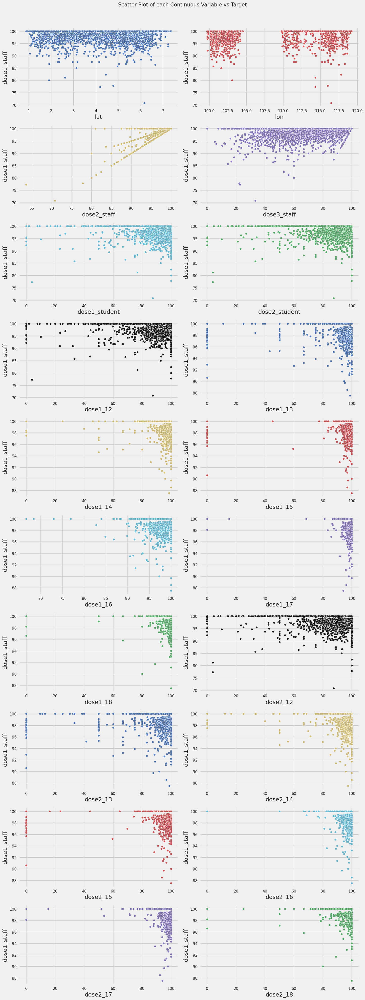

Number of All Scatter Plots = 210


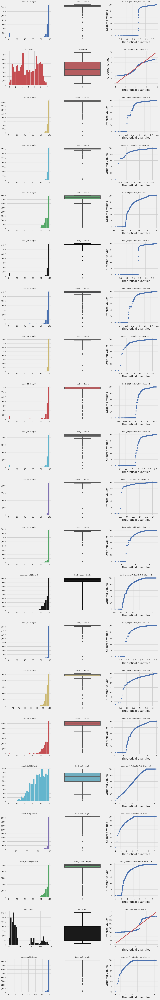

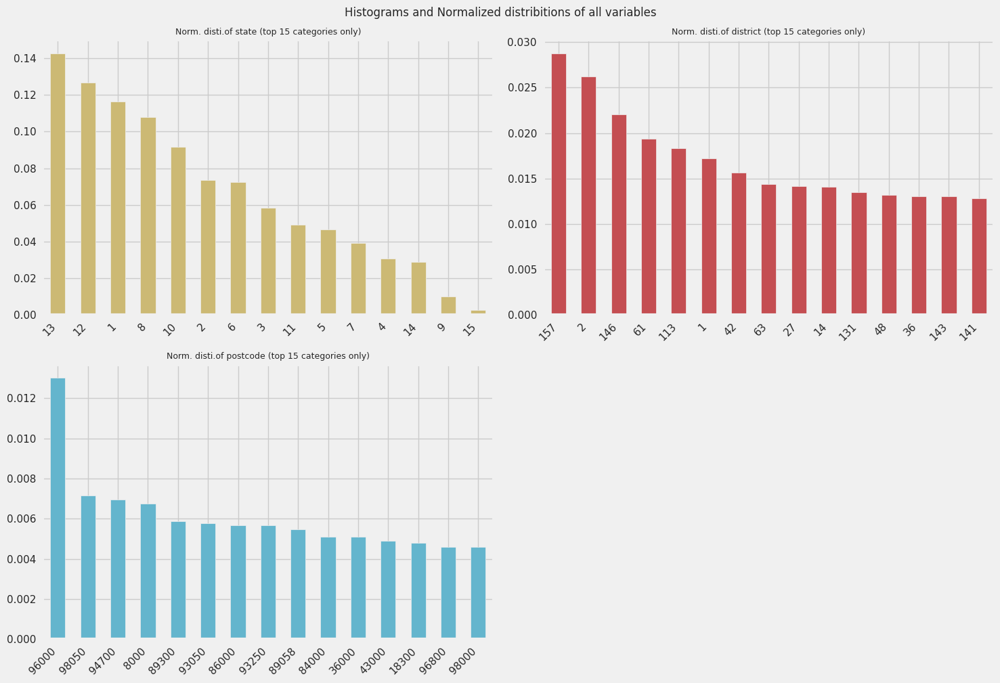

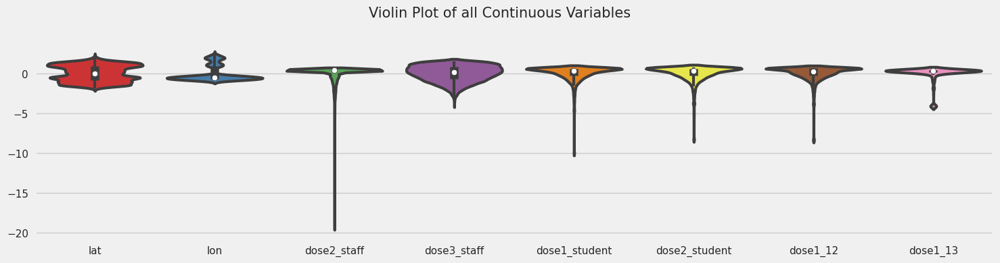

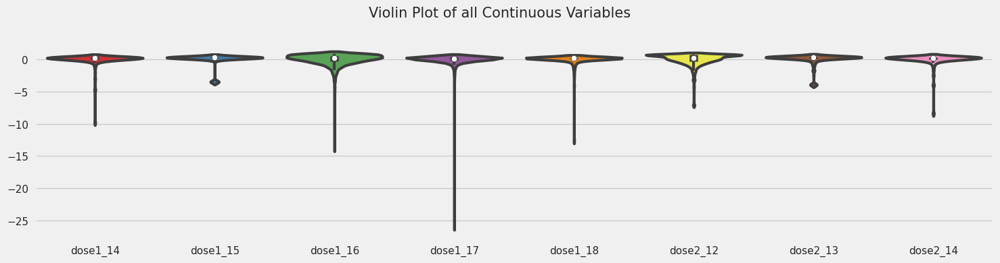

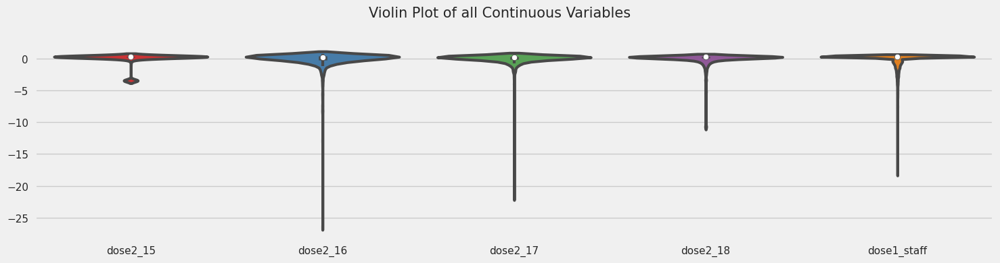

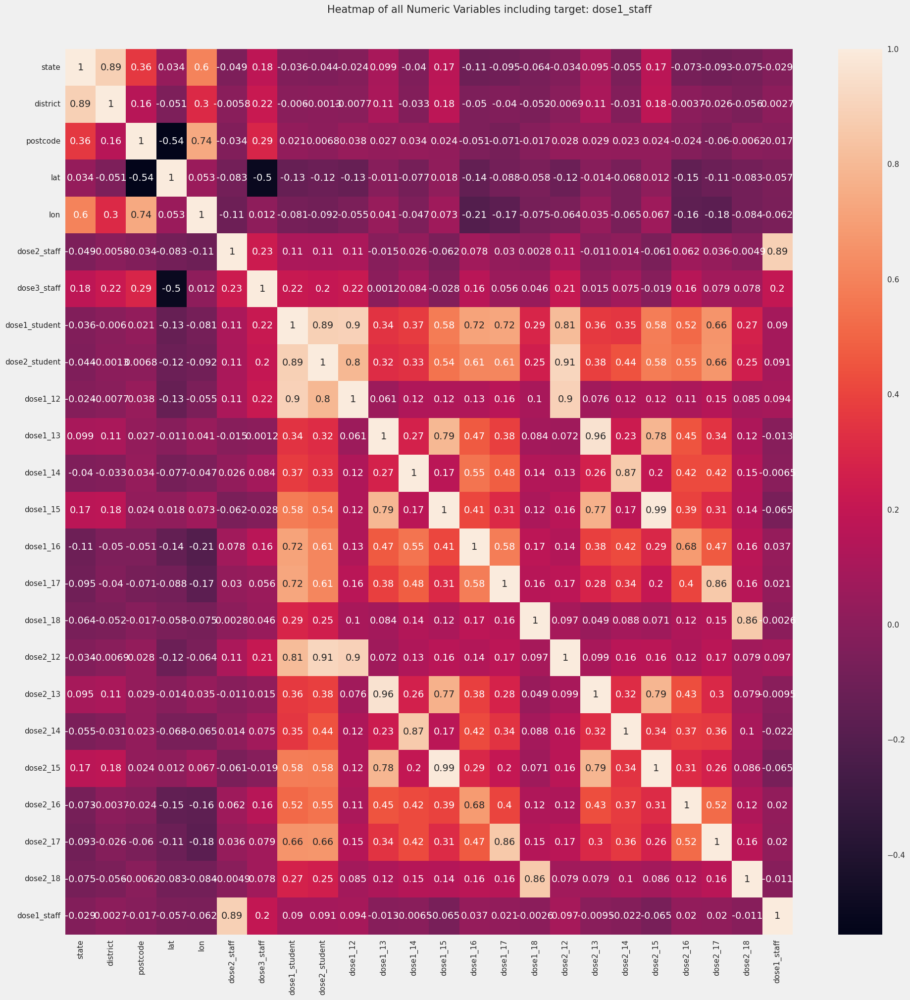

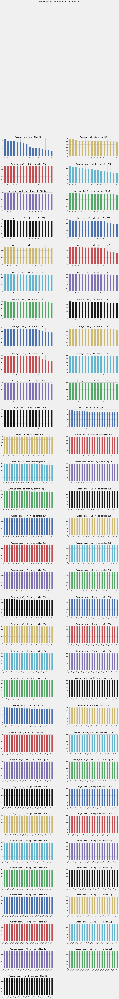

[nltk_data] Downloading collection 'popular'
[nltk_data]    | 
[nltk_data]    | Downloading package cmudict to /root/nltk_data...
[nltk_data]    |   Package cmudict is already up-to-date!
[nltk_data]    | Downloading package gazetteers to /root/nltk_data...
[nltk_data]    |   Package gazetteers is already up-to-date!
[nltk_data]    | Downloading package genesis to /root/nltk_data...
[nltk_data]    |   Package genesis is already up-to-date!
[nltk_data]    | Downloading package gutenberg to /root/nltk_data...
[nltk_data]    |   Package gutenberg is already up-to-date!
[nltk_data]    | Downloading package inaugural to /root/nltk_data...
[nltk_data]    |   Package inaugural is already up-to-date!
[nltk_data]    | Downloading package movie_reviews to
[nltk_data]    |     /root/nltk_data...
[nltk_data]    |   Package movie_reviews is already up-to-date!
[nltk_data]    | Downloading package names to /root/nltk_data...
[nltk_data]    |   Package names is already up-to-date!
[nltk_data]    | Do

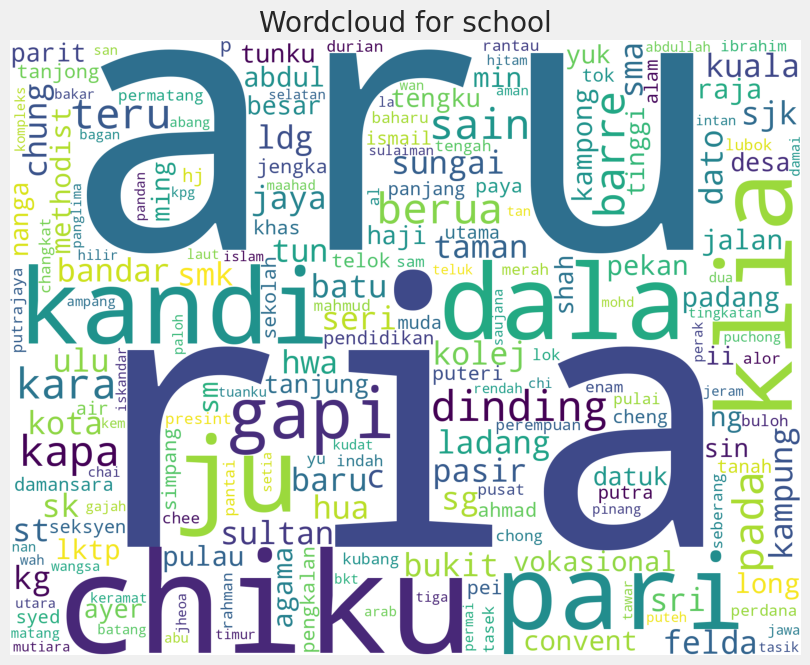

All Plots done
Time to run AutoViz = 137 seconds 

 ###################### AUTO VISUALIZATION Completed ########################


In [ ]:
# Generate visualizations and specify a local output file
report = AV.AutoViz(
   filename="",  # Specify a local output file path
   sep=',',
   depVar='dose1_staff',
   dfte=url,  # Pass the URL directly
   header=0,
   verbose=0,
   lowess=False,
   chart_format='png',
   max_rows_analyzed=150000,
   max_cols_analyzed=30,
)



## AutoViz provides data cleaning suggestions

8. AutoViz performs an automatic analysis of your dataset and offers recommendations for data cleaning. It can detect missing values, recognize infrequent categories, pinpoint infinite values, identify mixed data types, and much more. These capabilities greatly enhance the efficiency of your data cleaning tasks.

In [ ]:
from autoviz import data_cleaning_suggestions
data_cleaning_suggestions(data)

,Data Type,Missing Values%,Unique Values%,Minimum Value,Maximum Value,DQ Issue
code,object,0.000000,100,nan,nan,"Possible ID colum: drop before modeling process., 10216 rare categories: Too many to list. Group them into a single category or drop the categories., high cardinality with 10216 unique values: Use hash encoding or embedding to reduce dimension."
school,object,0.000000,94,nan,nan,"9607 rare categories: Too many to list. Group them into a single category or drop the categories., high cardinality with 9607 unique values: Use hash encoding or embedding to reduce dimension."
state,int64,0.000000,0,1.000000,16.000000,No issue
district,int64,0.000000,1,1.000000,159.000000,has a high correlation with ['state']. Consider dropping one of them.
postcode,int64,0.000000,10,1000.000000,98850.000000,No issue
lat,float64,0.000000,NA,0.889139,7.359100,No issue
lon,float64,0.000000,NA,99.715322,119.255970,No issue
dose1_staff,float64,0.039154,NA,70.800000,100.000000,"4 missing values. Impute them with mean, median, mode, or a constant value such as 123., has 2042 outliers greater than upper bound (100.00) or lower than lower bound(100.00). Cap them or remove them."
dose2_staff,float64,0.039154,NA,63.600000,100.000000,"4 missing values. Impute them with mean, median, mode, or a constant value such as 123., has 2476 outliers greater than upper bound (100.00) or lower than lower bound(100.00). Cap them or remove them., has a high correlation with ['dose1_staff']. Consider dropping one of them."
dose3_staff,float64,0.039154,NA,0.000000,100.000000,"4 missing values. Impute them with mean, median, mode, or a constant value such as 123., has 30 outliers greater than upper bound (128.75) or lower than lower bound(18.75). Cap them or remove them."


,Data Type,Missing Values%,Unique Values%,Minimum Value,Maximum Value,DQ Issue
code,object,0.000000,100,NaN,NaN,"Possible ID colum: drop before modeling process., 10216 rare categories: Too many to list. Group them into a single category or drop the categories., high cardinality with 10216 unique values: Use hash encoding or embedding to reduce dimension."
school,object,0.000000,94,NaN,NaN,"9607 rare categories: Too many to list. Group them into a single category or drop the categories., high cardinality with 9607 unique values: Use hash encoding or embedding to reduce dimension."
state,int64,0.000000,0,1.000000,16.00000,No issue
district,int64,0.000000,1,1.000000,159.00000,has a high correlation with ['state']. Consider dropping one of them.
postcode,int64,0.000000,10,1000.000000,98850.00000,No issue
lat,float64,0.000000,NA,0.889139,7.35910,No issue
lon,float64,0.000000,NA,99.715322,119.25597,No issue
dose1_staff,float64,0.039154,NA,70.800000,100.00000,"4 missing values. Impute them with mean, median, mode, or a constant value such as 123., has 2042 outliers greater than upper bound (100.00) or lower than lower bound(100.00). Cap them or remove them."
dose2_staff,float64,0.039154,NA,63.600000,100.00000,"4 missing values. Impute them with mean, median, mode, or a constant value such as 123., has 2476 outliers greater than upper bound (100.00) or lower than lower bound(100.00). Cap them or remove them., has a high correlation with ['dose1_staff']. Consider dropping one of them."
dose3_staff,float64,0.039154,NA,0.000000,100.00000,"4 missing values. Impute them with mean, median, mode, or a constant value such as 123., has 30 outliers greater than upper bound (128.75) or lower than lower bound(18.75). Cap them or remove them."


### Pros and Cons Analysis

**Pros**:

**Automation:** AutoViz automates the process of data visualization, saving you time and effort by automatically generating a variety of plots and charts for your dataset. This can be especially useful for quickly exploring large datasets.

**Quick Initial Insights:** AutoViz provides a fast way to get initial insights into your data without the need for manually specifying visualization types or parameters. It can generate a wide range of charts to help you understand your data's characteristics.

**No Coding Required:**  You don't need to be a data visualization expert or have advanced coding skills to use AutoViz. It's designed to be user-friendly and accessible for those who may not have extensive programming experience.
Interactive Plots: AutoViz supports interactive plotting, making it easier to explore your data in more detail. You can zoom in on specific data points or interact with the charts to gain a deeper understanding.
Supports Different Data Types: AutoViz is capable of handling various data types, including numerical, categorical, and time series data. It can generate appropriate visualizations for each data type.


**Cons:**

**Limited Customization:**  While AutoViz is designed to be user-friendly, it may not offer the same level of customization and control over visualizations that you would have with more manual approaches or dedicated data visualization libraries like Matplotlib or Seaborn. If you have specific customization requirements, AutoViz may not meet your needs.

**Overwhelming Output:**  AutoViz can generate a large number of visualizations, which can be overwhelming for complex datasets. It's important to review the generated visualizations carefully to focus on the most relevant insights.

**Dependent on Data Quality:**  The quality of the visualizations generated by AutoViz depends on the quality of the input data. If your data is messy or contains missing values, AutoViz may not be able to compensate for these issues, and you might need to clean the data before obtaining meaningful visualizations.

**May Not Cover All Use Cases:**  AutoViz may not cover every specific use case or type of data analysis. In some cases, you may still need to create custom visualizations or use other data visualization libraries to address your unique requirements.

### Conclusion

In conclusion, AutoViz proves to be a valuable tool for data analysis, offering a wide range of benefits and advantages. This automated visualization tool streamlines the data exploration process, making it accessible to both novice and experienced analysts. It excels in several key areas.

Firstly, AutoViz significantly reduces the time required for data analysis by automating the visualization process, which is crucial in today's fast-paced business environment where quick insights lead to more informed decision-making. Secondly, the tool offers a diverse array of visualization options, ensuring that analysts can explore their data from multiple angles. This not only enhances the depth of analysis but also enables a more comprehensive understanding of the data.

Moreover, AutoViz is designed to be user-friendly, making it accessible to individuals with varying levels of expertise in data analysis. Its intuitive interface allows even those without extensive coding or data visualization experience to create meaningful visuals. The automated nature of AutoViz encourages analysts to explore the data thoroughly, uncovering hidden patterns, anomalies, and insights that might have otherwise gone unnoticed. It also helps in generating insights quickly, driving better decision-making and problem-solving across various domains.

Additionally, AutoViz enables the easy reproduction of analysis and visuals, which is vital for maintaining data integrity and sharing results with others. While it automates the process, it still allows for customization, allowing analysts to fine-tune the visualizations to suit their specific needs and preferences.

However, it's important to remember that AutoViz is not a one-size-fits-all solution. It may not handle extremely complex or highly specialized data analysis tasks as effectively as manual approaches or other specialized tools. Therefore, analysts should consider the nature of their data and objectives before choosing AutoViz as their primary analysis tool.

In summary, AutoViz is a powerful tool for data analysis that significantly enhances the efficiency, accessibility, and depth of the data exploration process. Its ability to automate visualization tasks, coupled with customization options, makes it a valuable asset for both beginners and experts in the field of data analysis. However, it should be used judiciously, in conjunction with other analysis techniques, to ensure the most comprehensive and accurate results.

## Reference

1. https://medium.datadriveninvestor.com/autoviz-the-key-to-effortless-data-visualization-4b930b0c5ad9